In [102]:
import pandas as pd
import numpy as np
import alphalens as ap


In [103]:
def get_matrix(df, col_name: str):
    """
    输出DataFrame行索引为datetime， 列索引为symbol
    """
    matrix_df = df.pivot(index="datetime", columns="symbol", values=col_name)
    matrix_df.index = pd.to_datetime(matrix_df.index)
    matrix_df.index = matrix_df.index.tz_convert('Asia/Shanghai')
    return matrix_df


In [104]:
df = pd.read_csv(r"C:\Users\27418\Desktop\ashare_bar_data.csv",dtype={'symbol': str})

In [105]:
close = get_matrix(df, "close_price")

In [106]:
volume = get_matrix(df, "volume")

In [164]:
turnover = get_matrix(df, "turnover")

In [133]:
open_price = get_matrix(df, "open_price")
next_open = open_price.shift(-1)
next_open = next_open.iloc[:-1]
next_open = next_open.replace([np.inf, -np.inf], np.nan)

# Factor1--Volatility Factor

In [44]:
#日间对数收益率
log_ret = np.log(close)
log_ret = log_ret.diff()

In [45]:
volatility_30d = log_ret.rolling(window=30).std()
volatility_30d = volatility_30d.iloc[:-1]

In [46]:
volatility_30d = - volatility_30d.stack()

In [47]:
volatility_30d.head()

datetime                   symbol
2019-02-20 08:00:00+08:00  000001   -0.017869
                           000002   -0.016017
                           000004   -0.016383
                           000006   -0.015713
                           000007   -0.042544
dtype: float64

In [48]:
mean_vol = volatility_30d.mean()
std_vol = volatility_30d.std()
volatility_30d = (volatility_30d-mean_vol) / std_vol

In [49]:
volatility_30d.describe()

count    4.799757e+06
mean    -2.652827e-16
std      1.000000e+00
min     -1.363948e+01
25%     -5.496632e-01
50%      1.611033e-01
75%      7.416878e-01
max      2.243076e+00
dtype: float64

In [51]:
data_vol = ap.utils.get_clean_factor_and_forward_returns(volatility_30d, next_open, quantiles=5, periods=(1, 5, 10))

E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.


Dropped 1.0% entries from factor data: 1.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!


In [53]:
data_vol.isna().any(axis=1)

date                       asset 
2019-02-20 08:00:00+08:00  000001    False
                           000002    False
                           000004    False
                           000006    False
                           000007    False
                                     ...  
2023-12-14 08:00:00+08:00  688798    False
                           688799    False
                           688800    False
                           688819    False
                           688981    False
Length: 4753089, dtype: bool

Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-13.639479,0.135832,-1.444208,0.851715,951080,20.009754
2,-1.875858,0.664546,-0.338812,0.446361,950378,19.994984
3,-1.280849,1.012603,0.159596,0.407310,950399,19.995426
4,-0.815509,1.299121,0.561150,0.381107,950377,19.994963
5,-0.383823,2.243076,1.033271,0.380299,950848,20.004873


Returns Analysis


,1D,5D,10D
Ann. alpha,0.144,0.129,0.118
beta,-0.203,-0.156,-0.129
Mean Period Wise Return Top Quantile (bps),1.023,1.028,1.062
Mean Period Wise Return Bottom Quantile (bps),-5.906,-5.597,-5.365
Mean Period Wise Spread (bps),6.929,6.684,6.490


<Figure size 640x480 with 0 Axes>

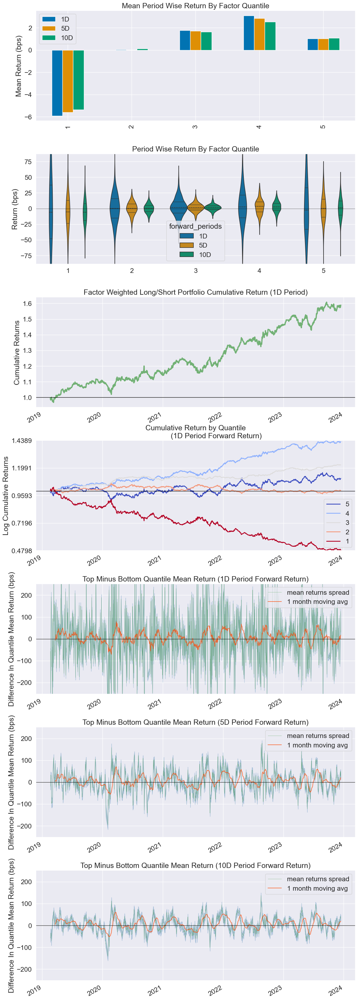

Information Analysis


,1D,5D,10D
IC Mean,0.045,0.072,0.086
IC Std.,0.169,0.161,0.162
Risk-Adjusted IC,0.264,0.450,0.528
t-stat(IC),9.037,15.428,18.086
p-value(IC),0.000,0.000,0.000
IC Skew,-0.007,-0.066,-0.159
IC Kurtosis,-0.319,-0.255,-0.332


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


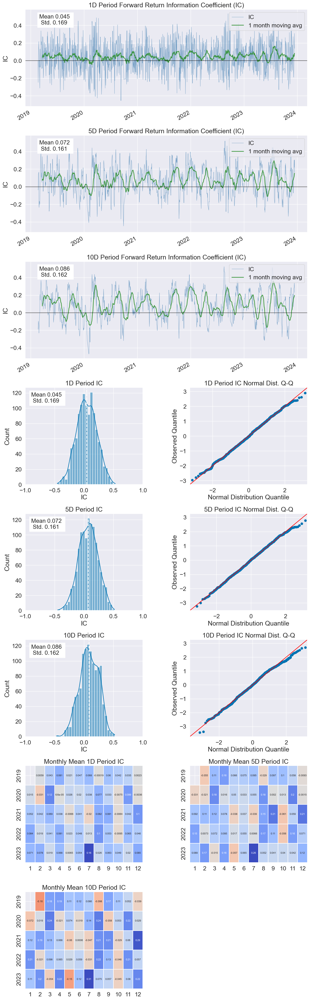

E:\python\python310\lib\site-packages\alphalens\utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,10D
Quantile 1 Mean Turnover,0.047,0.156,0.259
Quantile 2 Mean Turnover,0.111,0.325,0.481
Quantile 3 Mean Turnover,0.128,0.360,0.517
Quantile 4 Mean Turnover,0.115,0.325,0.473
Quantile 5 Mean Turnover,0.052,0.157,0.246


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.99,0.939,0.865


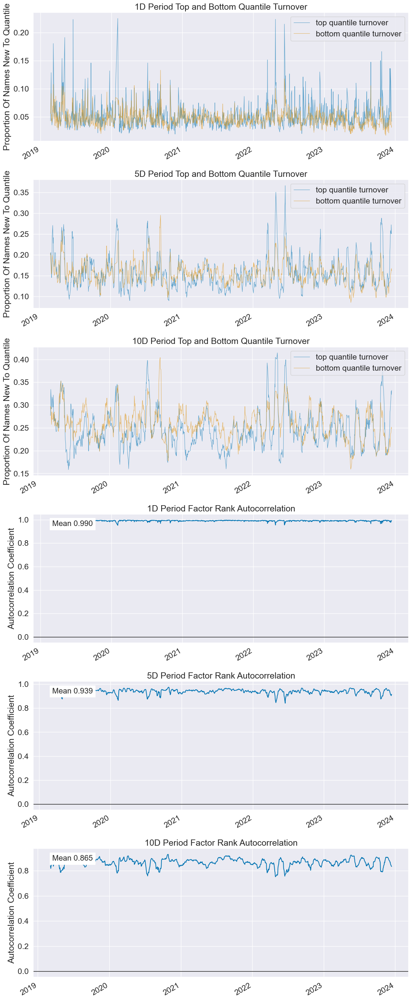

Information Analysis


,1D,5D,10D
IC Mean,0.045,0.072,0.086
IC Std.,0.169,0.161,0.162
Risk-Adjusted IC,0.264,0.450,0.528
t-stat(IC),9.037,15.428,18.086
p-value(IC),0.000,0.000,0.000
IC Skew,-0.007,-0.066,-0.159
IC Kurtosis,-0.319,-0.255,-0.332


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


<Figure size 640x480 with 0 Axes>

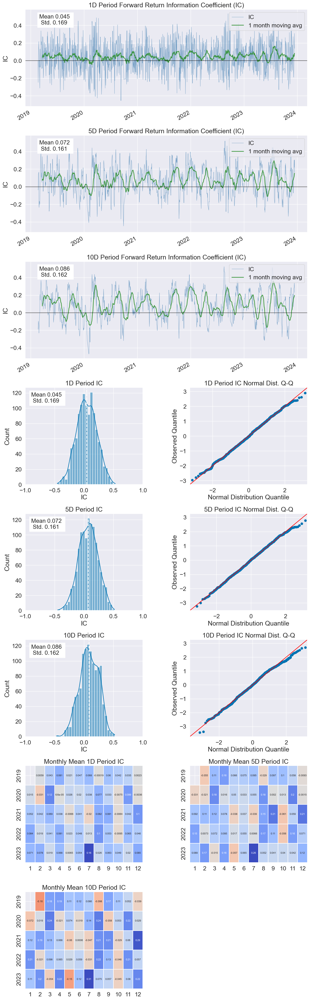

In [64]:
inf_mask = np.isinf(data_vol)
data_vol = data_vol[~inf_mask.any(axis=1)]
np.isinf(data_vol).any()
ap.tears.create_full_tear_sheet(data_vol)
ap.tears.create_information_tear_sheet(data_vol)

# Factor2--Momentum Factor

In [90]:
momentum_30d = close.pct_change(periods=30)

C:\Users\27418\AppData\Local\Temp\ipykernel_12772\1275559279.py:1: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  momentum_30d = close.pct_change(periods=30)


In [91]:
momentum_30d = momentum_30d.iloc[:-1]
momentum_30d = - momentum_30d.stack()

In [92]:
momentum_30d.head()

datetime                   symbol
2019-02-20 08:00:00+08:00  000001   -0.241566
                           000002   -0.156064
                           000004   -0.037384
                           000006   -0.108696
                           000007    0.236484
dtype: float64

In [93]:
mean_30d = momentum_30d.mean()
std_30d = momentum_30d.std()
momentum_30d = (momentum_30d-mean_30d) / std_30d

In [94]:
momentum_30d.describe()

count    4.867528e+06
mean     1.240797e-16
std      1.000000e+00
min     -7.248364e+01
25%     -3.961611e-01
50%      1.223089e-01
75%      5.697413e-01
max      5.263855e+00
dtype: float64

In [95]:
data_30d = ap.utils.get_clean_factor_and_forward_returns(momentum_30d, next_open, quantiles=5, periods=(1, 5, 10))

E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.


Dropped 1.0% entries from factor data: 1.0% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!


In [96]:
data_30d.isna().any(axis=1)

date                       asset 
2019-02-20 08:00:00+08:00  000001    False
                           000002    False
                           000004    False
                           000006    False
                           000007    False
                                     ...  
2023-12-14 08:00:00+08:00  688798    False
                           688799    False
                           688800    False
                           688819    False
                           688981    False
Length: 4820515, dtype: bool

Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-72.483641,0.761749,-1.249180,1.263524,964587,20.010119
2,-2.692080,1.224625,-0.212527,0.438504,963929,19.996469
3,-2.032036,1.598039,0.127025,0.407888,963976,19.997444
4,-1.625297,1.944312,0.408785,0.412175,963667,19.991034
5,-1.213279,4.940825,0.912740,0.524711,964337,20.004933


Returns Analysis


,1D,5D,10D
Ann. alpha,0.169,0.134,0.110
beta,-0.022,0.022,0.046
Mean Period Wise Return Top Quantile (bps),1.170,1.130,1.052
Mean Period Wise Return Bottom Quantile (bps),-6.870,-5.937,-5.014
Mean Period Wise Spread (bps),8.041,7.126,6.141


<Figure size 640x480 with 0 Axes>

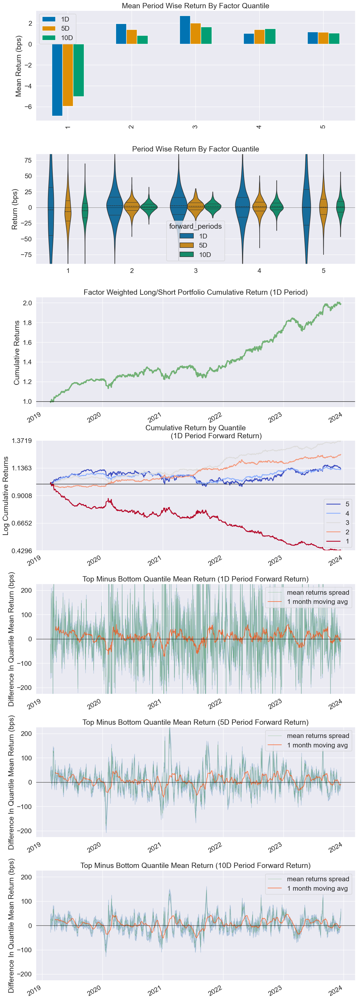

Information Analysis


,1D,5D,10D
IC Mean,0.032,0.051,0.060
IC Std.,0.149,0.137,0.134
Risk-Adjusted IC,0.213,0.374,0.447
t-stat(IC),7.283,12.804,15.301
p-value(IC),0.000,0.000,0.000
IC Skew,0.086,0.186,0.117
IC Kurtosis,0.225,0.131,0.185


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


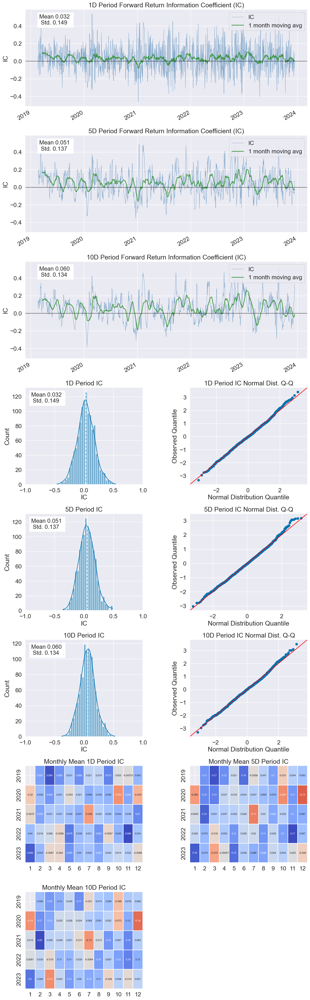

E:\python\python310\lib\site-packages\alphalens\utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,10D
Quantile 1 Mean Turnover,0.133,0.307,0.437
Quantile 2 Mean Turnover,0.313,0.567,0.673
Quantile 3 Mean Turnover,0.365,0.609,0.699
Quantile 4 Mean Turnover,0.336,0.579,0.678
Quantile 5 Mean Turnover,0.157,0.354,0.496


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.951,0.774,0.585


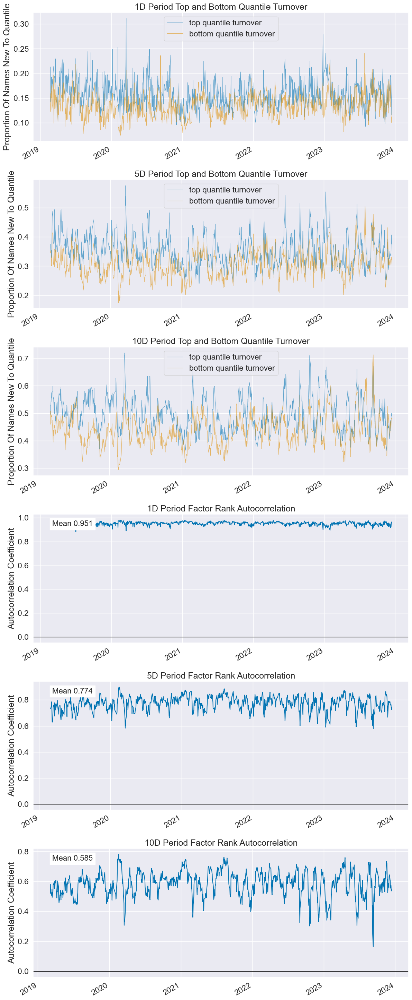

Information Analysis


,1D,5D,10D
IC Mean,0.032,0.051,0.060
IC Std.,0.149,0.137,0.134
Risk-Adjusted IC,0.213,0.374,0.447
t-stat(IC),7.283,12.804,15.301
p-value(IC),0.000,0.000,0.000
IC Skew,0.086,0.186,0.117
IC Kurtosis,0.225,0.131,0.185


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


<Figure size 640x480 with 0 Axes>

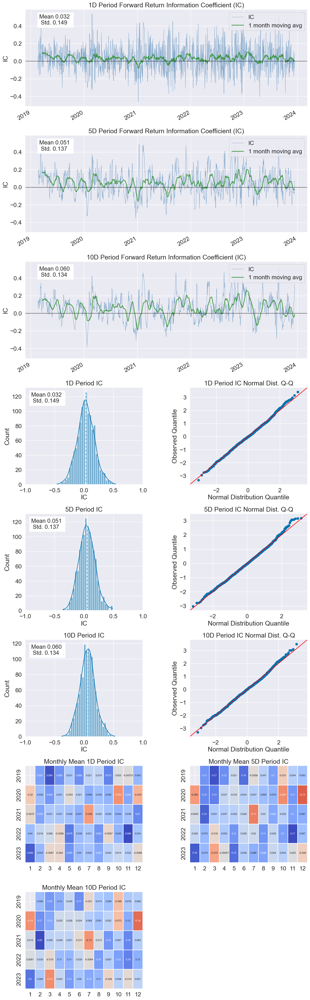

In [97]:
inf_mask = np.isinf(data_30d)
data_30d = data_30d[~inf_mask.any(axis=1)]
np.isinf(data_30d).any()
ap.tears.create_full_tear_sheet(data_30d)
ap.tears.create_information_tear_sheet(data_30d)

# Factor3--VPT

In [122]:
vpt_increment = volume * (close - close.shift(1)) / close.shift(1)
vpt_increment = vpt_increment.fillna(0)

In [123]:
vpt = vpt_increment.cumsum()
vpt.iloc[0] = 0

In [124]:
vpt = - vpt.stack()

In [127]:
mean_vpt = vpt.mean()
std_vpt = vpt.std()
vpt = (vpt-mean_vpt) / std_vpt

In [128]:
vpt.describe()

count    5.710656e+06
mean     9.989755e-17
std      1.000000e+00
min     -4.343000e+01
25%     -5.954447e-03
50%      2.848104e-01
75%      3.798318e-01
max      2.600844e+00
dtype: float64

In [129]:
data_vpt = ap.utils.get_clean_factor_and_forward_returns(vpt, next_open, quantiles=5, periods=(1, 5, 10))

E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.


Dropped 13.2% entries from factor data: 13.1% in forward returns computation and 0.1% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!


In [130]:
data_vpt.isna().any(axis=1)

date                       asset 
2019-01-03 08:00:00+08:00  000001    False
                           000002    False
                           000004    False
                           000006    False
                           000007    False
                                     ...  
2023-12-14 08:00:00+08:00  688798    False
                           688799    False
                           688800    False
                           688819    False
                           688981    False
Length: 4959222, dtype: bool

Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1.0,-43.430003,0.395814,-1.136175,1.965328,992337,20.010010
2.0,-0.729571,0.396092,-0.027693,0.246139,991744,19.998052
3.0,-0.118088,0.396204,0.200461,0.113600,991454,19.992204
4.0,0.159811,0.398006,0.315764,0.048576,991581,19.994765
5.0,0.318480,2.600844,0.388680,0.050481,992087,20.004969


Returns Analysis


,1D,5D,10D
Ann. alpha,0.118,0.102,0.096
beta,-0.056,-0.047,-0.058
Mean Period Wise Return Top Quantile (bps),3.968,2.967,2.495
Mean Period Wise Return Bottom Quantile (bps),-4.556,-3.950,-3.680
Mean Period Wise Spread (bps),8.524,6.920,6.179


<Figure size 640x480 with 0 Axes>

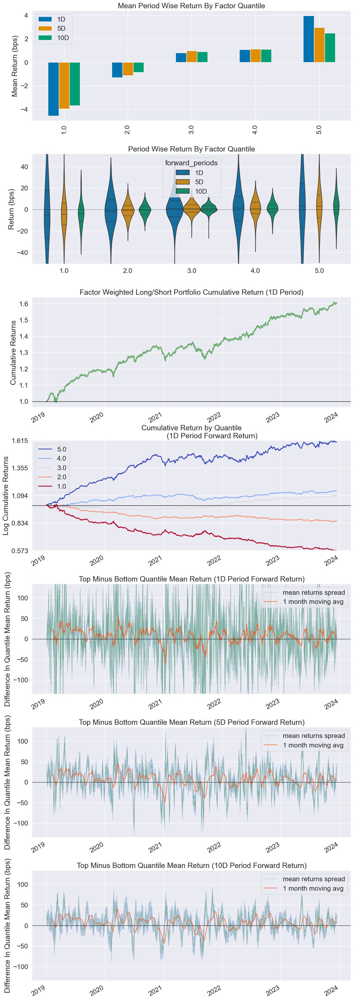

Information Analysis


,1D,5D,10D
IC Mean,0.013,0.024,0.029
IC Std.,0.097,0.107,0.108
Risk-Adjusted IC,0.132,0.220,0.270
t-stat(IC),4.576,7.636,9.360
p-value(IC),0.000,0.000,0.000
IC Skew,-0.024,-0.016,-0.059
IC Kurtosis,-0.120,-0.148,0.118


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


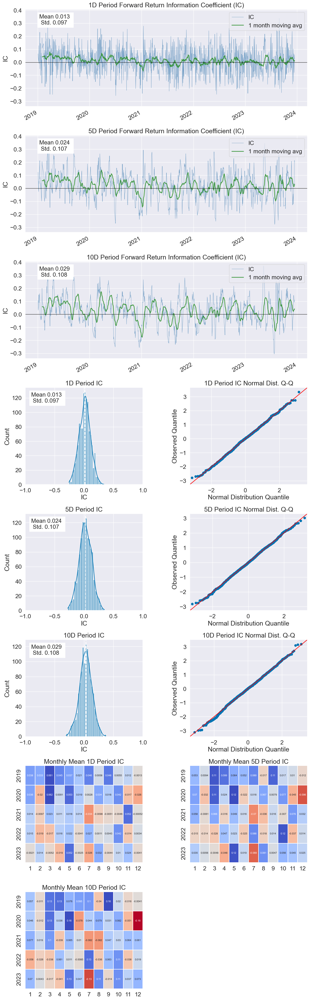

E:\python\python310\lib\site-packages\alphalens\utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,10D
Quantile 1.0 Mean Turnover,0.010,0.026,0.038
Quantile 2.0 Mean Turnover,0.025,0.059,0.085
Quantile 3.0 Mean Turnover,0.029,0.070,0.099
Quantile 4.0 Mean Turnover,0.028,0.067,0.095
Quantile 5.0 Mean Turnover,0.015,0.040,0.061


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.998,0.991,0.985


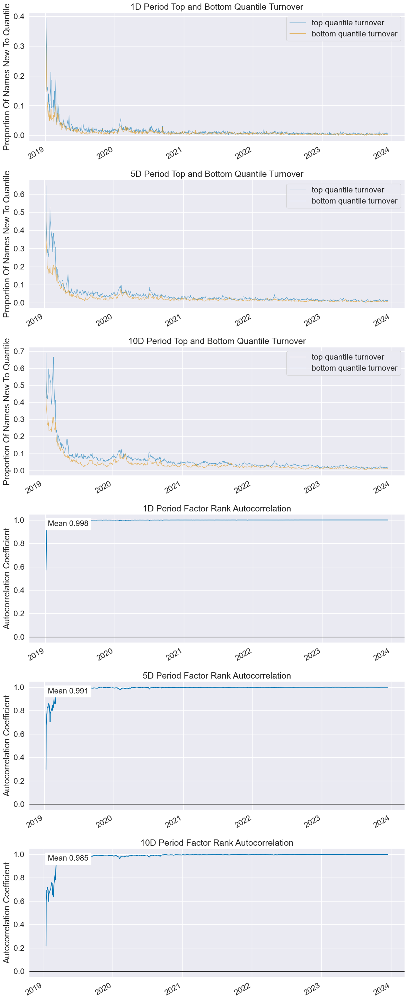

Information Analysis


,1D,5D,10D
IC Mean,0.013,0.024,0.029
IC Std.,0.097,0.107,0.108
Risk-Adjusted IC,0.132,0.220,0.270
t-stat(IC),4.576,7.636,9.360
p-value(IC),0.000,0.000,0.000
IC Skew,-0.024,-0.016,-0.059
IC Kurtosis,-0.120,-0.148,0.118


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


<Figure size 640x480 with 0 Axes>

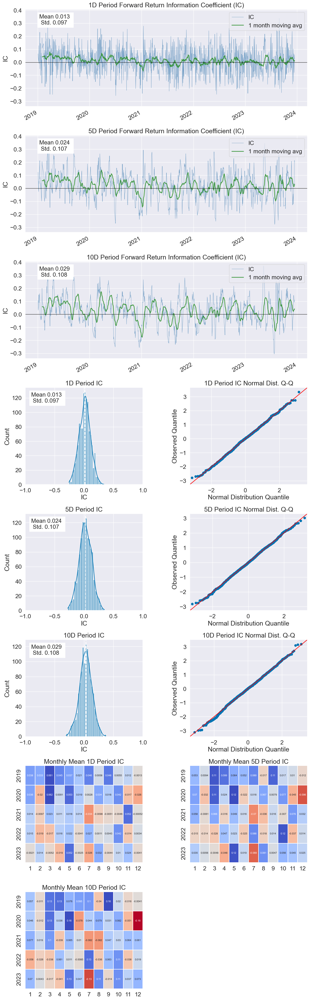

In [131]:
inf_mask = np.isinf(data_vpt)
data_vpt = data_vpt[~inf_mask.any(axis=1)]
np.isinf(data_vpt).any()
ap.tears.create_full_tear_sheet(data_vpt)
ap.tears.create_information_tear_sheet(data_vpt)

# Factor4--Overnight Gap Factor

In [138]:
log_return = np.log(open_price / close.shift(1))

# 取绝对值
abs_log_return = log_return.abs()

# 计算20天滚动和
absRet_night = abs_log_return.rolling(window=20).sum()

E:\python\python310\lib\site-packages\pandas\core\internals\blocks.py:393: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


In [139]:
absRet_night = - absRet_night.stack()

In [140]:
mean_absRet_night = absRet_night.mean()
std_absRet_night = absRet_night.std()
absRet_night = (absRet_night-mean_absRet_night) / std_absRet_night
absRet_night.describe()

count    4.870223e+06
mean    -4.291423e-16
std      1.000000e+00
min     -1.846145e+01
25%     -3.111461e-01
50%      2.698694e-01
75%      6.378135e-01
max      1.452206e+00
dtype: float64

In [141]:
data_absRet_night = ap.utils.get_clean_factor_and_forward_returns(absRet_night, next_open, quantiles=5, periods=(1, 5, 10))

E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.


Dropped 1.1% entries from factor data: 1.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!


In [142]:
data_absRet_night.isna().any(axis=1)

date                       asset 
2019-01-30 08:00:00+08:00  000001    False
                           000002    False
                           000004    False
                           000006    False
                           000007    False
                                     ...  
2023-12-14 08:00:00+08:00  688798    False
                           688799    False
                           688800    False
                           688819    False
                           688981    False
Length: 4818775, dtype: bool

Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-18.128032,0.282756,-1.340502,1.276351,964229,20.009861
2,-3.127063,0.636161,-0.155468,0.506603,963509,19.994920
3,-2.407068,0.815921,0.216523,0.429934,963527,19.995293
4,-1.866983,0.963585,0.480271,0.373314,963509,19.994920
5,-1.270543,1.403098,0.772827,0.314123,963995,20.005005


Returns Analysis


,1D,5D,10D
Ann. alpha,0.158,0.142,0.127
beta,-0.171,-0.141,-0.119
Mean Period Wise Return Top Quantile (bps),0.999,1.061,1.155
Mean Period Wise Return Bottom Quantile (bps),-5.052,-4.634,-4.243
Mean Period Wise Spread (bps),6.051,5.734,5.432


<Figure size 640x480 with 0 Axes>

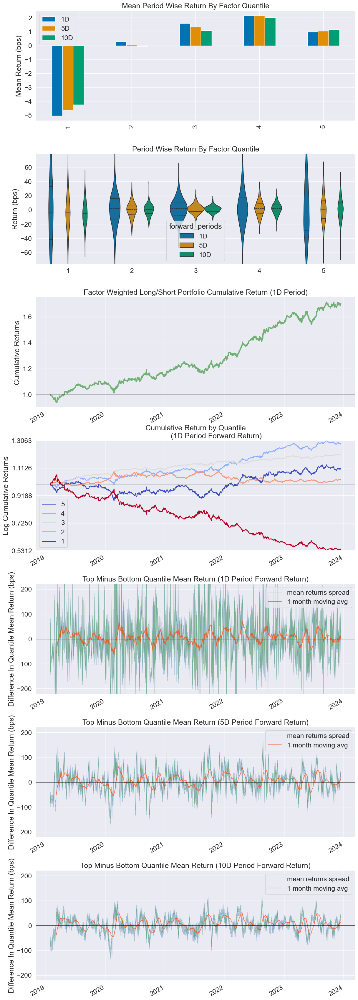

Information Analysis


,1D,5D,10D
IC Mean,0.038,0.063,0.075
IC Std.,0.146,0.144,0.145
Risk-Adjusted IC,0.263,0.441,0.517
t-stat(IC),9.032,15.180,17.777
p-value(IC),0.000,0.000,0.000
IC Skew,-0.009,-0.108,-0.197
IC Kurtosis,-0.130,-0.092,0.128


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


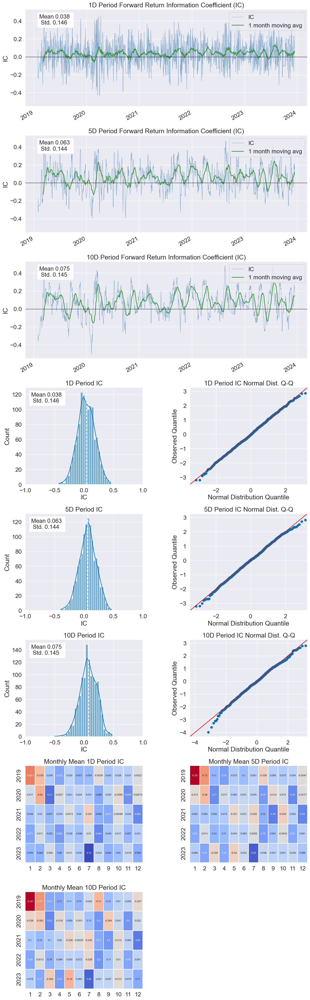

E:\python\python310\lib\site-packages\alphalens\utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,10D
Quantile 1 Mean Turnover,0.068,0.214,0.353
Quantile 2 Mean Turnover,0.165,0.429,0.592
Quantile 3 Mean Turnover,0.208,0.498,0.644
Quantile 4 Mean Turnover,0.199,0.473,0.618
Quantile 5 Mean Turnover,0.091,0.242,0.366


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.983,0.889,0.758


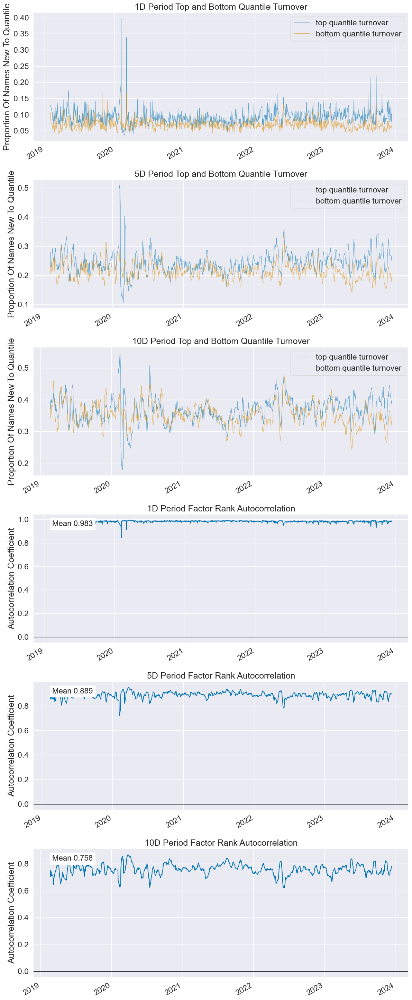

Information Analysis


,1D,5D,10D
IC Mean,0.038,0.063,0.075
IC Std.,0.146,0.144,0.145
Risk-Adjusted IC,0.263,0.441,0.517
t-stat(IC),9.032,15.180,17.777
p-value(IC),0.000,0.000,0.000
IC Skew,-0.009,-0.108,-0.197
IC Kurtosis,-0.130,-0.092,0.128


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


<Figure size 640x480 with 0 Axes>

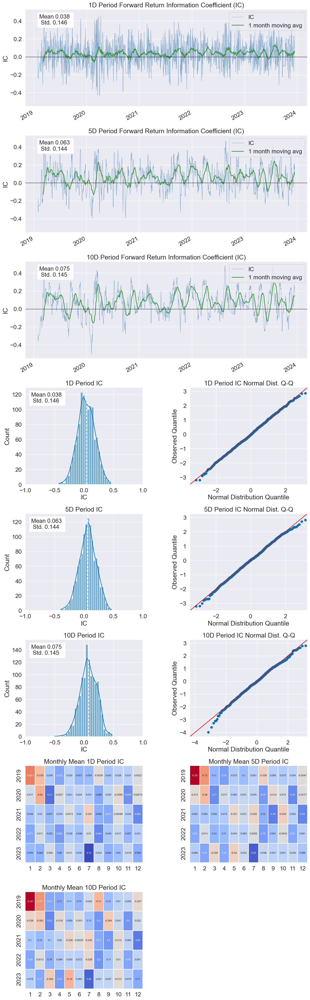

In [143]:
inf_mask = np.isinf(data_absRet_night)
data_absRet_night = data_absRet_night[~inf_mask.any(axis=1)]
np.isinf(data_absRet_night).any()
ap.tears.create_full_tear_sheet(data_absRet_night)
ap.tears.create_information_tear_sheet(data_absRet_night)

# Factor5--Coefficient of Variation of Illiquidity

In [156]:
returns = close.pct_change()

C:\Users\27418\AppData\Local\Temp\ipykernel_12772\503444150.py:1: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = close.pct_change()


In [157]:
# 计算阿莫迪流动性比率 (Amihud Illiquidity Ratio)
illiq = returns.abs() / volume
# 计算20天滚动标准差和均值
rolling_std = illiq.rolling(window=20).std()
rolling_mean = illiq.rolling(window=20).mean()
# 计算CVILLIQ
cvilliq = rolling_std / rolling_mean

In [158]:
cvilliq = - cvilliq.stack()

In [159]:
mean_cvilliq = cvilliq.mean()
std_cvilliq = cvilliq.std()
cvilliq = (cvilliq-mean_cvilliq) / std_cvilliq

In [160]:
cvilliq.describe()

count    4.872002e+06
mean    -1.144743e-15
std      1.000000e+00
min     -1.257068e+01
25%     -1.697919e-01
50%      1.627027e-01
75%      4.461523e-01
max      1.839505e+00
dtype: float64

In [161]:
data_cvilliq = ap.utils.get_clean_factor_and_forward_returns(cvilliq, next_open, quantiles=5, periods=(1, 5, 10))

E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.


Dropped 1.1% entries from factor data: 1.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!


In [162]:
data_cvilliq.isna().any(axis=1)

date                       asset 
2019-01-30 08:00:00+08:00  000001    False
                           000002    False
                           000004    False
                           000006    False
                           000007    False
                                     ...  
2023-12-14 08:00:00+08:00  688798    False
                           688799    False
                           688800    False
                           688819    False
                           688981    False
Length: 4820547, dtype: bool

Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-12.570683,-0.001437,-0.945202,1.462137,964566,20.009497
2,-8.594327,0.246054,-0.186263,0.877914,963882,19.995308
3,-6.864642,0.432641,0.084930,0.662702,963848,19.994602
4,-3.785264,0.653197,0.348787,0.320057,963884,19.995349
5,-0.854928,1.839505,0.692743,0.210344,964361,20.005244


Returns Analysis


,1D,5D,10D
Ann. alpha,0.031,0.017,0.018
beta,-0.013,-0.012,-0.008
Mean Period Wise Return Top Quantile (bps),-1.188,-1.417,-0.891
Mean Period Wise Return Bottom Quantile (bps),-1.117,-0.388,-0.566
Mean Period Wise Spread (bps),-0.071,-1.027,-0.327


<Figure size 640x480 with 0 Axes>

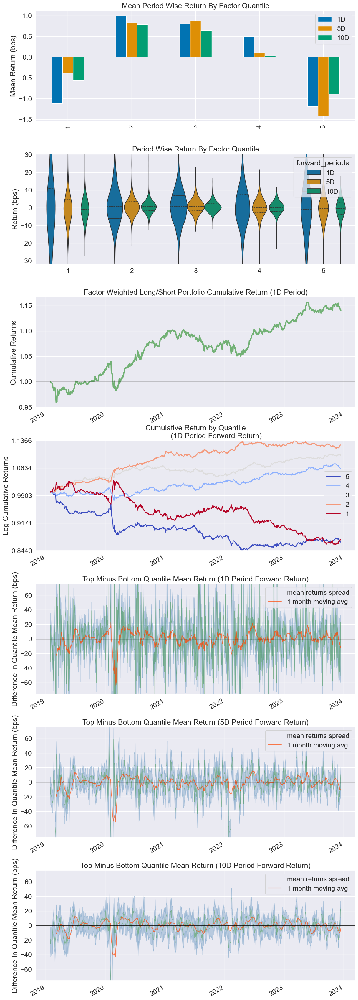

Information Analysis


,1D,5D,10D
IC Mean,0.000,-0.000,0.001
IC Std.,0.053,0.058,0.058
Risk-Adjusted IC,0.008,-0.003,0.012
t-stat(IC),0.275,-0.093,0.410
p-value(IC),0.783,0.926,0.682
IC Skew,-0.630,-1.912,-2.430
IC Kurtosis,3.776,9.733,16.089


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


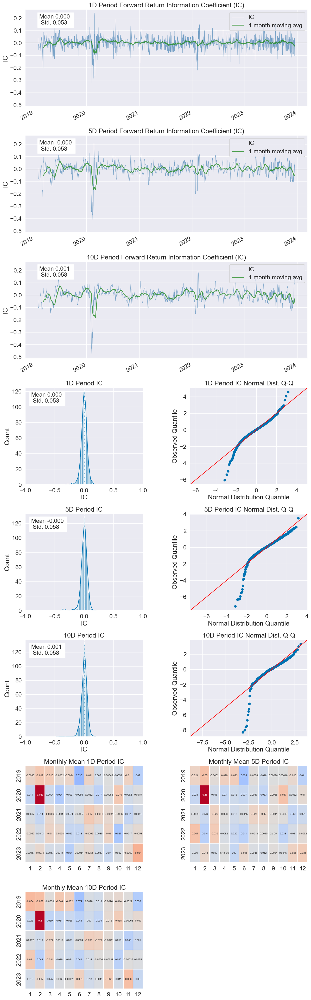

E:\python\python310\lib\site-packages\alphalens\utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,10D
Quantile 1 Mean Turnover,0.158,0.387,0.561
Quantile 2 Mean Turnover,0.363,0.648,0.738
Quantile 3 Mean Turnover,0.426,0.694,0.765
Quantile 4 Mean Turnover,0.386,0.666,0.746
Quantile 5 Mean Turnover,0.174,0.413,0.583


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.94,0.712,0.458


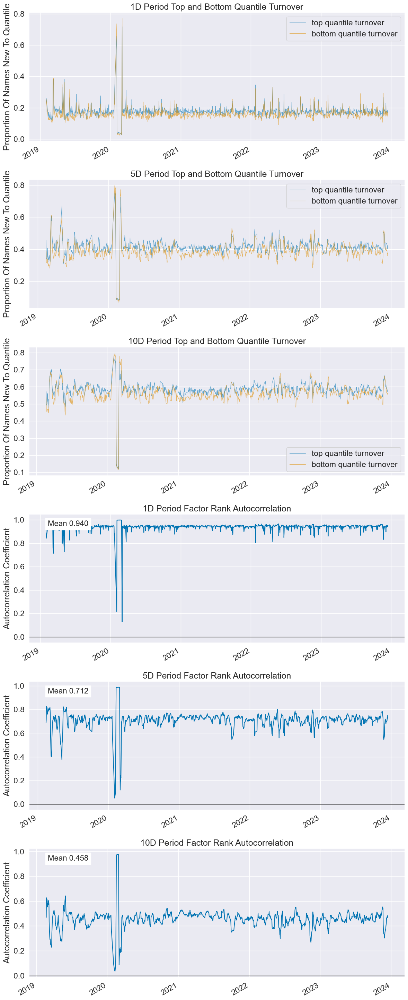

Information Analysis


,1D,5D,10D
IC Mean,0.000,-0.000,0.001
IC Std.,0.053,0.058,0.058
Risk-Adjusted IC,0.008,-0.003,0.012
t-stat(IC),0.275,-0.093,0.410
p-value(IC),0.783,0.926,0.682
IC Skew,-0.630,-1.912,-2.430
IC Kurtosis,3.776,9.733,16.089


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


<Figure size 640x480 with 0 Axes>

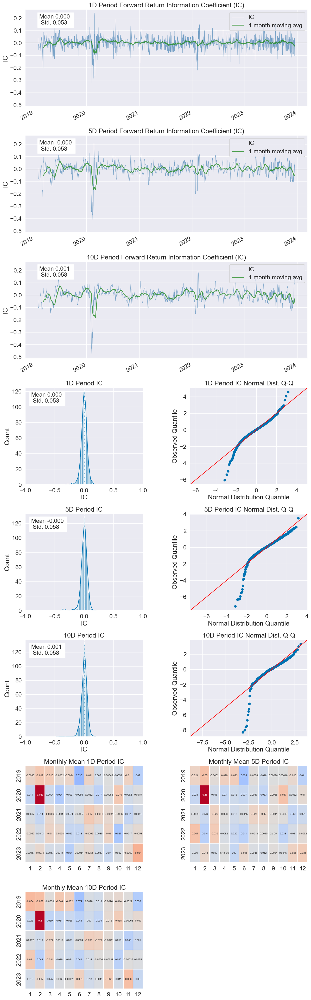

In [163]:
inf_mask = np.isinf(data_cvilliq)
data_cvilliq = data_cvilliq[~inf_mask.any(axis=1)]
np.isinf(data_cvilliq).any()
ap.tears.create_full_tear_sheet(data_cvilliq)
ap.tears.create_information_tear_sheet(data_cvilliq)

# Factor6--Turnover volatility factor

In [173]:
# 计算滚动均值和滚动标准差
rolling_mean = turnover.rolling(window=60).mean()
rolling_std = turnover.rolling(window=60).std()
# 计算均值和标准差的比值
mean_std_ratio = rolling_mean / rolling_std

In [174]:
mean_std_ratio = mean_std_ratio.stack()

In [175]:
mean_mean_std_ratio = mean_std_ratio.mean()
std_mean_std_ratio = mean_std_ratio.std()
mean_std_ratio = (mean_std_ratio - mean_mean_std_ratio) / std_mean_std_ratio
mean_std_ratio.describe()

count    4.616283e+06
mean     2.519969e-15
std      1.000000e+00
min     -2.530637e+00
25%     -7.384141e-01
50%     -1.114602e-01
75%      6.188003e-01
max      8.186495e+00
dtype: float64

In [176]:
data_mean_std_ratio = ap.utils.get_clean_factor_and_forward_returns(mean_std_ratio, next_open, quantiles=5, periods=(1, 5, 10))

E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  returns = prices.pct_change(period)
E:\python\python310\lib\site-packages\alphalens\utils.py:308: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.


Dropped 1.1% entries from factor data: 1.1% in forward returns computation and 0.0% in binning phase (set max_loss=0 to see potentially suppressed Exceptions).
max_loss is 35.0%, not exceeded: OK!


Quantiles Statistics


,min,max,mean,std,count,count %
factor_quantile,,,,,,
1,-2.530637,-0.648093,-1.245997,0.285138,913519,20.010203
2,-1.089799,-0.080152,-0.604891,0.176733,912803,19.994519
3,-0.744811,0.533761,-0.098827,0.199404,912854,19.995637
4,-0.414741,1.536128,0.462665,0.269221,912803,19.994519
5,-0.017980,8.186495,1.468354,0.649611,913287,20.005121


Returns Analysis


,1D,5D,10D
Ann. alpha,0.049,0.045,0.041
beta,-0.062,-0.055,-0.049
Mean Period Wise Return Top Quantile (bps),1.325,1.397,1.487
Mean Period Wise Return Bottom Quantile (bps),-2.060,-1.776,-1.510
Mean Period Wise Spread (bps),3.385,3.173,2.990


<Figure size 640x480 with 0 Axes>

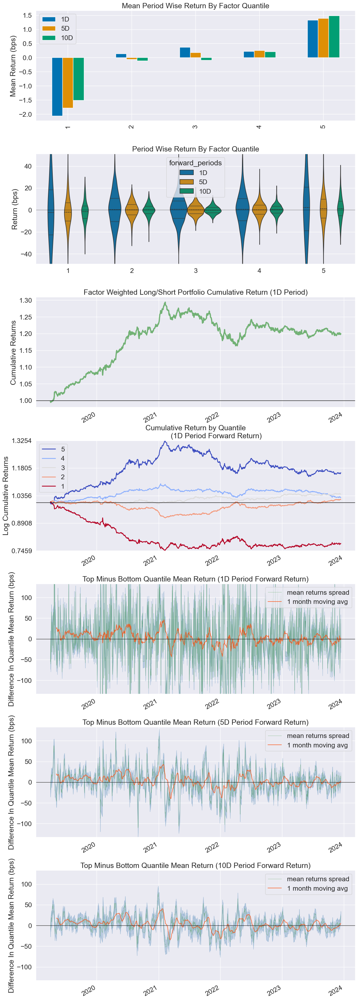

Information Analysis


,1D,5D,10D
IC Mean,0.018,0.029,0.033
IC Std.,0.088,0.087,0.089
Risk-Adjusted IC,0.202,0.329,0.372
t-stat(IC),6.842,11.129,12.597
p-value(IC),0.000,0.000,0.000
IC Skew,-0.041,-0.050,0.027
IC Kurtosis,-0.193,-0.018,-0.092


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


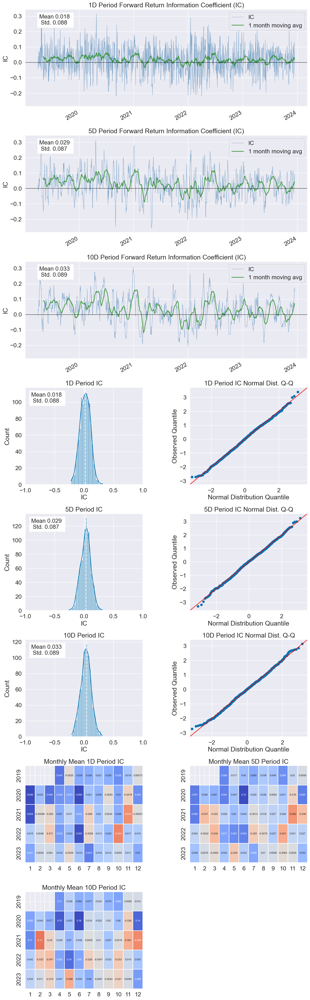

E:\python\python310\lib\site-packages\alphalens\utils.py:928: UserWarning: Skipping return periods that aren't exact multiples of days.
  warnings.warn(


Turnover Analysis


,1D,5D,10D
Quantile 1 Mean Turnover,0.038,0.157,0.274
Quantile 2 Mean Turnover,0.083,0.285,0.453
Quantile 3 Mean Turnover,0.100,0.331,0.506
Quantile 4 Mean Turnover,0.095,0.313,0.478
Quantile 5 Mean Turnover,0.046,0.168,0.280


,1D,5D,10D
Mean Factor Rank Autocorrelation,0.99,0.914,0.81


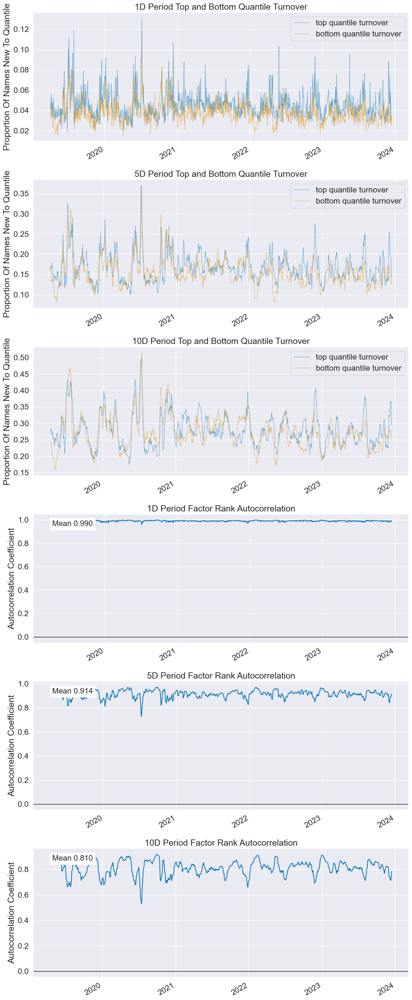

Information Analysis


,1D,5D,10D
IC Mean,0.018,0.029,0.033
IC Std.,0.088,0.087,0.089
Risk-Adjusted IC,0.202,0.329,0.372
t-stat(IC),6.842,11.129,12.597
p-value(IC),0.000,0.000,0.000
IC Skew,-0.041,-0.050,0.027
IC Kurtosis,-0.193,-0.018,-0.092


E:\python\python310\lib\site-packages\alphalens\performance.py:118: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  grouper.append(pd.Grouper(freq=by_time))


<Figure size 640x480 with 0 Axes>

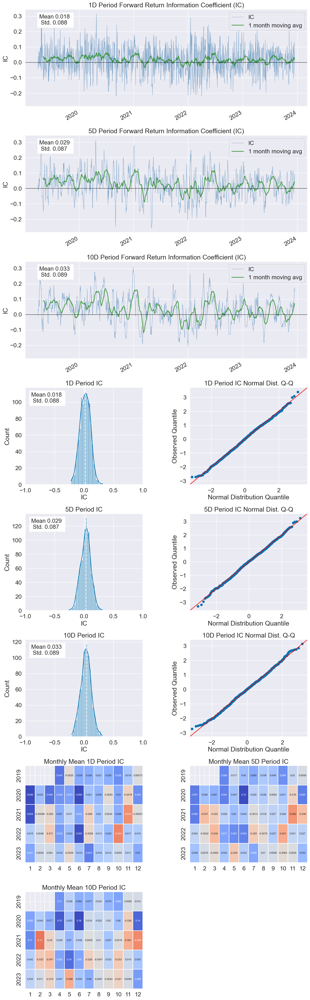

In [177]:
data_mean_std_ratio.isna().any(axis=1)
inf_mask = np.isinf(data_mean_std_ratio)
data_mean_std_ratio = data_mean_std_ratio[~inf_mask.any(axis=1)]
np.isinf(data_mean_std_ratio).any()
ap.tears.create_full_tear_sheet(data_mean_std_ratio)
ap.tears.create_information_tear_sheet(data_mean_std_ratio)